# <center> Ovarian Cancer Lipidome Dynamics in a _Dicer-Pten_ <br> Double-Knockout Mouse Model </center>


## <center> `Lipidomic trajectory clusters` </center>

#### <center>`Olatomiwa O. Bifarin, Ph.D.`</center> <center>Postdoctoral Fellow</center> <center>School of Chemistry & Biochemistry</center> <center>Georgia Institute of Technology </center> <img src="images/GTlogo.png" style="width:100px;height:100px"/> 

# Table of Contents
<a id='0'></a>

1. [Introduction](#1)
    - [Datasets imported and generated in this notebook.](#1.1) 
    - [Data struture descriptions](#1.2)
    - [Import python libraries and primary data](#1.3)
2. [Global significant metabolites](#2)
    - [Significant lipids DKO _vs_ control mice, for all time points combined](#2.1)
    - [Significant lipids DKO _vs_ control mice, for each stage bins](#2.2)
    - [Overlapping significant lipids between stage bins](#2.3)
3. [Longitudinal lipidomic trajectory](#3)
    - [Combined time-point fold changes](#3.1)
    - [Fold changes across time points/stages](#3.2)
    - [Hierarchical clustering analysis for lipidomic trajectories: DKO _vs_ Control](#3.3)
    - [Selected lipidomic clusters identified _via_ HCA](#3.4)
    - [Correlation network graphs for metabolic clusters](#3.5)
    - [HCA for lipidomic trajectories: DKO stages _vs_ DKO stage I](#3.6)
4. [Some code references](#4)

## 1. Introduction
<a id='1'></a>

### 1.1 Datasets imported and generated in this notebook. 
<a id='1.1'></a>

**Imported** <br>
1. `dko_annotated_updated.xlsx`: contains updated information on the dataset `dko_annotated.xlsx` after dataframe cleaning. It now includes, but not limited to, columns like lifetime percentages and binned stages.

**Generated** <br>

No dataset was exported. 


### 1.2 Data struture descriptions
<a id='1.2'></a>

**Dataframes** <br>
`df`: The entire study dataframe either annotated or unannotated <br>
`DKOdf`: A subset of DKO dataframe <br>
`controldf`: A subset of control animal dataframe <br>

**Lists or Pandas series** <br>
`features`: all features <br>
`sig_features`: all features with statistical difference (FDR<0.05) between control and DKO for all timepoints combined <br>
`overlap_metabolites`: statistically significant metabolites that overlapped between specific timepoints or binned timepoints.

**Functions** <br>
`Ttest`: Function conducts a T-test for the metabolites differences between two groups with Benjamini-Hocberg FDR correction <br>
`total_fold_change`: total fold change, all time points combined - log2 fold change (DKO/control) <br>
`timepoint_fold_change`: Function computes the log2 fold change for separate timepoints <br>
`hierarchical_clustering`: Function plots a HCA dendogram, clustering the trajectories of metabolites.<br>
`print_clusters`: Function plots the trajectory of all metabolic clusters<br>
`printsub_clusters`: This function generates line plots and heatmap summarizing longitudinal trend of data within a particular cluster<br>
`networkGraph`: An interative network graph for correlation network graph<br>

### 1.3 Import python libraries and primary data
<a id='1.3'></a>

In [1]:
import numpy as np
import pandas as pd
import scipy
import statsmodels as sms
from statsmodels.stats import multitest

from sklearn import decomposition
from matplotlib import pyplot as plt

import hvplot.pandas 
import holoviews as hv

#For Seaborn plots
import seaborn as sns; sns.set(style='white')

#To ignore warning
import warnings
warnings.filterwarnings('ignore')

# More sharp and legible graphics
%config InlineBackend.figure_format = 'retina'

Import annotated dataframe.

In [2]:
# import data
df = pd.read_excel('data/dko_annotated_updated.xlsx', index_col=[0])
df.head(3);

Save a new file called `dko_annotated_updated.xlsx` that contains updated information on the dataset after dataframe cleaning from previous notebook, `dko_annotated.xlxs`.


- `id`: refers to the combined `mice` sample id underscore `timepoint`, which are already made to have there own distinctive columns. <br>
- `age`: refers to the age of mice in weeks when blood samples are collected. <br>
- `lifetime`: since mice dies at different times by the effect of ovarian cancer, then % lifetime features is calculated for each sample, where %lifetime is the (age in weeks / total life span or age at death) X 100. <br>
- `stage_bin`: see definition above. <br>
- `death`: refers to the total life span or age at death.

### [Go to Table of Contents](#0) <br>

## 2. Global significant metabolites
<a id='2'></a>

In this session, the scripts calculate statistical significance of metabolites comparing DKO and control mice
- First for all time points combined, and 
- Next for each time points or stage bins.                                          

**A _T_-test function**

In [3]:
def Ttest(metabolites, dfControl, dfTreat, alpha=0.05, var=True):
    '''
    Function conducts a T-test for the metabolites differences between two groups with 
    Benjamini-Hocberg FDR correction
    
    Inputs: 
    metabolites = A list containing names of metabolites
    dfControl = A pandas dataframe containing the control group metabolites data
    dfTreat =  A pandas dataframe containing the treatment group metabolites data
    alpha = alpha for statistical significant judgment, default 0.05
    var = If True (default), perform a standard independent 2 sample test that assumes 
    equal population variances [1]. If False, perform Welch’s t-test, which does not 
    assume equal population variance
    
    Outputs: A pandas dataframe with p-values of numerical cohort characteristics. 
    
    '''
    ttest_dict = {}
    for metabolite in metabolites:
        statistic, pvalue =  scipy.stats.ttest_ind(dfControl[metabolite], 
                                               dfTreat[metabolite], 
                                               equal_var=var)
        ttest_dict[metabolite] = pvalue 
        # a dictionary containing name of metabolites and p value after t-test
    ttest = pd.DataFrame.from_dict(ttest_dict, orient='index') # the dictionary in pandas df
    ttest_list=list(ttest_dict.values()) #values (pvalues) of ttest result in a list
    reject, pval_corrected, _, _ = sms.stats.multitest.multipletests(ttest_list, 
                                                                 alpha=alpha, 
                                                                 method='fdr_bh')
    ttest_results = pd.DataFrame({'Metabolite': metabolites, 'T-test p-value': ttest_list, 
                              'FDR p-value': pval_corrected, 'Reject H0': reject})
    Table = ttest_results.sort_values(by=['FDR p-value'])
    return Table

**`features` refers to all metabolomic features in the dataframe**

In [4]:
# A list containing all metabolomic `features`
features = df.drop(['id', 'group', 'mice', 
                    'timepoint', 'age',
                    'lifetime', 'stage_bin',
                    'death'], axis=1).columns

How to select only DKO and control dataframe for _t_-test computations.

In [5]:
# How to select only DKO and control dataframe for t-test computations.

# STEP 1: create a dataframe that contains just the group and timepoint, 
# that is, drop id and sample from the non-numeric columns. 

''' df.drop(['id', 'mice'], axis=1) '''

# STEP 2: then create a boolean to select a particular timepoint (e.g. T1). 

''' [df['timepoint']=='T1'] '''

# STEP 3: Split the dataframe into controls vs. DKO.

''' [df['group']=='control']'''

#df.drop(['id', 'mice', 'age', 'lifetime', 'stage_bin', 'death'], axis=1);

control = df.drop(['id', 'mice', 'age', 
                   'lifetime', 'stage_bin', 
                   'death'], axis=1)[df['group']=='control']
DKO = df.drop(['id', 'mice', 'age', 
               'lifetime', 'stage_bin', 
               'death'], axis=1)[df['group']=='DKO']

### 2.1 Significant lipids DKO _vs_ control mice, for all time points combined
<a id='2.1'></a>

In [6]:
print("The total number of DKO mice:", DKO.shape[0])
print("The total number of control:", control.shape[0])

The total number of DKO mice: 221
The total number of control: 238


Given the unequal sample sizes of the two groups to be compared, the Welch _T_ test is used. For the function, please select `var=False`.

In [7]:
# dataframe showing full ttest result.
ttest_result = Ttest(features, control, DKO, alpha=0.05, var=False)

# list of statistically relevant metabolites
# Select metabolites with <0.05 FDR
stat_sig_all = ttest_result.loc[ttest_result['Reject H0'] == True]

# If no significant metabolites were selected using the FDR cut off, 
# select metabolites with p value < 0.05 i.e. the t-test without FDR correction. 
# using the code below. 

'''stat_sig_all = ttest_result.loc[ttest_result['T-test p-value'] <= 0.05]'''

print("The total number of significant lipidomic features is: ", len(stat_sig_all))

# Define a new dataframe with just the significant metabolite
sig_features = stat_sig_all['Metabolite']

The total number of significant lipidomic features is:  87


**`sig_features` refers to all statistical significant metabolomic features in the dataframe (for combined timepoints)**

Here is the list of all the `sig_features`.

In [8]:
sig_features.tolist();

An histogram plot showing the distribution of the FDR corrected _p_ value.

### [Go to Table of Contents](#0) <br>

### 2.2 Significant lipids DKO _vs_ control mice, for each stage bins
<a id='2.2'></a>

In [9]:
timepoints = ['I', 'II', 'III', 'IV', 'V']
store = []
for i in timepoints:
    control = df.drop(['id', 'mice'], axis=1)[df['stage_bin']==i][df['group']=='control']
    DKO = df.drop(['id', 'mice'], axis=1)[df['stage_bin']==i][df['group']=='DKO']
    
    # dataframe showing full ttest result.
    ttest_result = Ttest(features, control, DKO, alpha=0.05, var=False)
    
    # Select metabolites with <0.05 t-test
    stat_sig = ttest_result.loc[ttest_result['T-test p-value'] <= 0.05]
    
    # list of statistically relevant metabolites
    # select metabolites with <0.05 FDR
    # stat_sig = ttest_result.loc[ttest_result['Reject H0'] == True]
    store.append(len(stat_sig))
print(store)

[14, 121, 56, 136, 298]


An Interactive table and bar chart showing significant metabolites for each time points/bins

In [10]:
sigmetabolite_tp = pd.DataFrame(
    {'timepoints': timepoints, 
     '# significant metabolite (p<0.05)': store})

In [11]:
(sigmetabolite_tp.hvplot.bar(x='timepoints', y='# significant metabolite (p<0.05)', width = 400, height=300) +
 sigmetabolite_tp.hvplot.table(['timepoints', '# significant metabolite (p<0.05)'], width=500))

:Layout
   .Bars.I  :Bars   [timepoints]   (# significant metabolite (p<0.05))
   .Table.I :Table   [timepoints,# significant metabolite (p<0.05)]

If you want only the plot output, perhaps because you want to resave the figure, please run the line of code below.

In [12]:
#sigmetabolite_tp.hvplot.bar(x='timepoints')

### [Go to Table of Contents](#0) <br>

### 2.3 Overlapping significant lipids between stage bins
<a id='2.3'></a>

In [13]:
from functools import reduce

In [14]:
# feel free to edit stage bins analyzed.

timepoints = ['III', 'IV', 'V']
store = []
sig_metabolite_list = []
for i in timepoints:
    control = df.drop(['id', 'mice'], axis=1)[df['stage_bin']==i][df['group']=='control']
    DKO = df.drop(['id', 'mice'], axis=1)[df['stage_bin']==i][df['group']=='DKO']
    # dataframe showing full ttest result.
    ttest_result = Ttest(features, control, DKO, alpha=0.05, var=False)
    
    # Select metabolites with <0.05 t-test
    stat_sig = ttest_result.loc[ttest_result['T-test p-value'] <= 0.05]
    
    # list of statistically relevant metabolites
    # select metabolites with <0.05 FDR
    # stat_sig = ttest_result.loc[ttest_result['Reject H0'] == True]
    
    # collect significant metabolites in a list. 
    sig_metabolite_list.append(stat_sig['Metabolite'].tolist())
    
    store.append(len(stat_sig))
print(store)
overlap_metabolites = list(reduce(set.intersection, [set(item) for item in sig_metabolite_list]))
print(len(overlap_metabolites))    

[56, 136, 298]
4


In [15]:
overlap_metabolites

[' Prostaglandin A1 ethyl ester;;',
 ' PC(O-40:7);PC(O-40:7).3',
 ' Cer(d41:2) M + CH3COOH;;',
 ' Cer(d33:1) M + CH3COOH;;']

### [Go to Table of Contents](#0) <br>

## 3. Longitudinal lipidomic trajectory
<a id='3'></a>

Create DKO and control dataframes.

In [16]:
DKOdf = df.loc[df['group'] == 'DKO'] # DKO only dataframe
controldf = df.loc[df['group'] == 'control'] # control only dataframe
stageVdf = df[df['stage_bin']=='V'] # Specific stage dataframe, in this case, stage V.

#### There are numerous dataframes to plot using the following building blocks: <br>
**Dataframes** <br>
`df`: entire study dataframe <br>
`DKOdf`: DKO dataframe <br>
`controldf`: Control dataframe <br>

**Input features** <br>
`features`: all lipidomic features <br>
`sig_features`: all features with statistical difference (FDR<0.05) between control and DKO, all timepoints combined <br>
`overlap_metabolites`: overlapping metabolites bewteen multiple stages. 

**Columns name for color codes** <br>
`group`: control _vs._ DKO <br>
`mice`: samples <br>
`timepoint`: T01-T20 <br>
`stage_bin`: I - V

### 3.1 Combined time-point fold changes
<a id='3.1'></a>

In [17]:
print(len(features))
print(len(sig_features))
print(len(overlap_metabolites))

1070
87
4


$$ \large Log_{2} FC [\frac{\text {DKO}}{\text {control}}] \text {    for combined timepoints}$$

In [18]:
def total_fold_change(metabolites, title):
    '''
    Function: Total fold change, all time points combined - log2 fold change (DKO/control)
    
    Input:
    metabolites: pandas series, list of metabolomic features
    title: string, title of graph.
    Output: 
    An interactive plot
    '''
    
    dfmean = pd.DataFrame({'Features': metabolites.tolist(),
                       # control: compute mean for all selected metabolic features
                       'control': controldf[metabolites].mean(axis = 0),
                       # DKO: compute mean for all selected metabolic features
                       # remove the current index which are currently the features
                       'DKO': DKOdf[metabolites].mean(axis = 0)}).reset_index(drop=True)
    
    # log2 fold changes (dko/control)
    fc_changes = [np.log2(oc/ctr) for oc, ctr in zip(dfmean['DKO'], dfmean['control'])]
    
    # dataframe for results with features and log2FC
    foldchange_df = pd.DataFrame(list(zip(dfmean['Features'], 
                                          fc_changes)), 
                                 columns=['Features','Log2FC'])
    # plot figures via hvplot
    return foldchange_df.hvplot.bar(x='Features', 
                         y='Log2FC',
                         alpha=0.8,
                         width=900, height=350,
                         color='teal',
                         xlabel='Metabolites',
                         ylabel='Log_2 Fold Change (DKO/CTR)',
                         legend = 'top',
                         title=title)
    #foldchange_df.plot.bar(x='Features', y='Log2FC', figsize=(15,5));

In [19]:
total_fold_change(features, 'All annotated features - all timepoints combined')

:Bars   [Features]   (Log2FC)

Export image as `svg`.

In [20]:
#plot = total_fold_change(features, 'All annotated features - all timepoints combined')
#hv.extension('matplotlib')
#hvplot.save(plot, 'plot.svg', fmt='svg')
#hv.extension('bokeh')

In [21]:
total_fold_change(sig_features, 
                  '87 features with p < 0.05 - all timepoints combined')

:Bars   [Features]   (Log2FC)

Export image as `svg`.

In [22]:
#plot = total_fold_change(sig_features, 
#                  '87 features with q < 0.05 - all timepoints combined')
#hv.extension('matplotlib')
#hvplot.save(plot, 'plot.svg', fmt='svg')
#hv.extension('bokeh')

In [23]:
total_fold_change(pd.Series(overlap_metabolites), 
                  '4 overlapping features with stage III-V t-test - all timepoints combined')

:Bars   [Features]   (Log2FC)

In [24]:
#plot = total_fold_change(pd.Series(overlap_metabolites), 
#                  '4 overlapping features with stage III-V t-test - all timepoints combined')
#hv.extension('matplotlib')
#hvplot.save(plot, 'plot.svg', fmt='svg')
#hv.extension('bokeh')

**Total fold changes for three serum potential prognostics.** 

In [25]:
serum_prog = pd.Series([' PC(39:4);PC(39:4).3', ' PC(37:2);PC(37:2).2', ' PC(O-40:7);PC(O-40:7).3'])

In [26]:
total_fold_change(serum_prog, 
                  'Potential serum prognostics identified')

:Bars   [Features]   (Log2FC)

In [27]:
#plot = total_fold_change(serum_prog, 'Potential serum prognostics identified')
#hv.extension('matplotlib')
#hvplot.save(plot, 'plot.svg', fmt='svg')
#hv.extension('bokeh')

### [Go to Table of Contents](#0) <br>

### 3.2 Fold changes across time points/stages
<a id='3.2'></a>


$$ \large Log_{2} FC [\frac{\text {DKO}}{\text {control}}] \text {    for the seperate stage bins}$$


In [28]:
def timepoint_fold_change(metabolites, timepoints, method='normalize to control'):
    '''
    Function computes the log2 fold change for separate timepoints. 
    Input: 
    metabolites: A pandas series. It contains the list of metabolites to interogate.
    timepoints: A list. This is a list of all the timepoints, or bins of timepoints created. 
    method: normalize to control for each timepoint ('normalize to control') or 
    normalize to dko first timepoint ('normalize to timepoint1')
    Output: 
    A pandas dataframe. 
    '''
    
    store_fc = []
    # Create a dataframe that compute the mean of all timepoints for each metabolomic feature.
    for i in timepoints:
        if method == 'normalize to control':
            control = controldf[controldf['stage_bin'] == i]
            dko = DKOdf[DKOdf['stage_bin'] == i]
            mean = pd.DataFrame({'Features': metabolites.tolist(),
                                 'control': control[metabolites].mean(axis=0),
                                 'DKO': dko[metabolites].mean(axis=0)
                                })
        elif method == 'normalize to timepoint1': 
            dko = DKOdf[DKOdf['stage_bin'] == i]
            dko_base = DKOdf[DKOdf['stage_bin'] == 'I']
            mean = pd.DataFrame({'Features': metabolites.tolist(),
                                 'control': dko_base[metabolites].mean(axis=0),
                                 'DKO': dko[metabolites].mean(axis=0)
                                })
        
        mean.reset_index(drop=True)
        # log2 fold changes (dko/control)
        fc_changes = [np.log2(oc/ctr) for oc, ctr in zip(mean['DKO'], mean['control'])]
        store_fc.append(fc_changes)
        # Create the pandas DataFrame
        store_fc_df = pd.DataFrame(store_fc)
        store_fc_df = store_fc_df.transpose()
    
    store_fc_df.columns = timepoints
    store_fc_df['features'] = metabolites.tolist()
    return store_fc_df

In [29]:
stages = ['I', 'II', 'III', 'IV', 'V']
timepoint_fold_change(features, stages, 'normalize to control');

plot result as a simple clustermap, example


In [30]:
dud = timepoint_fold_change(sig_features, stages, 'normalize to control')
waste = dud.pop('features')
#g = sns.clustermap(dud, col_cluster=False,  cmap="vlag")

### [Go to Table of Contents](#0) <br>

### 3.3 Hierarchical clustering analysis for lipidomic trajectories
<a id='3.3'></a>

Hierarchical clustering is an iterative algorithm to cluster the data based on group similarities. Hierarchical clustering gives a tree structure called `dendogram`.

A dataset of $n$ observations with each observation $x_{i} = (x_{i1}, ... , x_{ip})$ is a $p$ dimensional variable.

$n$ will be the number of observation.<br>
$x$ will be an observation.<br>
$p$ will be the number of time points/ stage bins. 

<s> $x=$ fold change computation values for each sample $i$ with $p$ metabolic features.</s>

A row, $x$, will be the fold change computation values overtime for a metabolic feature <br>
So $n=$ the number of metabolic features. 

**Distance Function**

The similarity is a `distance function` between two observations. 


$$ \large d(x_{i}, x_{j}) \ge 0. $$

The `Euclidean` distance between 1-D array _u_ and _v_, is defined as: 

$$ \large \|u-v\|_2$$

$$ = \left(\sum (u_{i} - v_{i})^2 \right)^{1/2} $$

The `correlation` distance between _u_ and _v_, is defined as: 

$$ \large 1 - \frac {(u - \bar u) \cdot (v - \bar v)} {\|u-\bar u\|_2 \|v-\bar v\|_2} $$

where $\bar u$ is the mean of the elements of $u$ and $p \cdot q$ is the dot product of $p$ and $q$.

**Linkage Function**

In order to merge two clusters into a larger one, we also need to measure the distance between `two clusters`. 

This is equivalent to measure the `distance between two sets of points`. 

$x_{1}, ... x_{n} = $ observations in cluster 1 <br>
$y_{1}, ... y_{m} = $ observations in cluster 2 <br>

$L_{1,2} = $ distance (linkage) between cluster 1 and cluster 2. 

`Complete Linkage`: Maximum distance between any single data point in the first cluster and any single data point in the second cluster. Average of distance of all pair. 

$$ \large L_{1,2} = \text {max}_{i,j} d (x_{i}, y_{j}) $$

`Average Linkage`: Average distance between data points in the first cluster and data points in the second cluster. Average of distance of all pairs. 

$$ \large L_{1,2} = \frac {1}{nm} \sum_{i=1}^{n} \sum_{i=1}^{m} d (x_{i}, y_{j})  $$

In [31]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
import scipy.cluster.hierarchy as hac

import plotly.figure_factory as ff

In [32]:
def hierarchical_clustering(metabolites, time_resolved_fc):
    '''
    Function plots a HCA dendogram, clustering the trajectories of metabolites.
    Input: 
    metabolites: A pandas series. It contains the list of metabolites to interogate.
    time_resolved_fc: a pandas dataframe output from `timepoint_fold_change`function. 
    It contains log2 fold change of metabolites
    
    Output: a dendogram
    
    '''
    
    
    # make the features, which is currently a column, the index of the dataframe.
    time_resolved_fc = time_resolved_fc.set_index('features')
    
    # computing the distance between observations in n-dimensional space
    # Link: https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.distance.pdist.html
    #c_dist = pdist(time_resolved_fc) 

    # computing the linkage, hierarchical/agglomerative clustering
    # Link: https://docs.scipy.org/doc/scipy/reference/generated/scipy.cluster.hierarchy.linkage.html#scipy.cluster.hierarchy.linkage
    
    # metric to try: euclidean or correlation
    # method to try: complete or average
    
    c_link = linkage(time_resolved_fc,  
                     metric='correlation', 
                     method='complete') 
    # Plot dendogram
    plt.figure(figsize=(25, 10))
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('Metabolites')
    plt.ylabel('Distance')
    hac.dendrogram(
        c_link,
        labels=metabolites.tolist(),
        leaf_rotation=75.,  # rotates the x axis labels
        leaf_font_size=12,  # font size for the x axis labels
    )
    #plt.savefig('AUCplots.svg', dpi=300)
    plt.show()

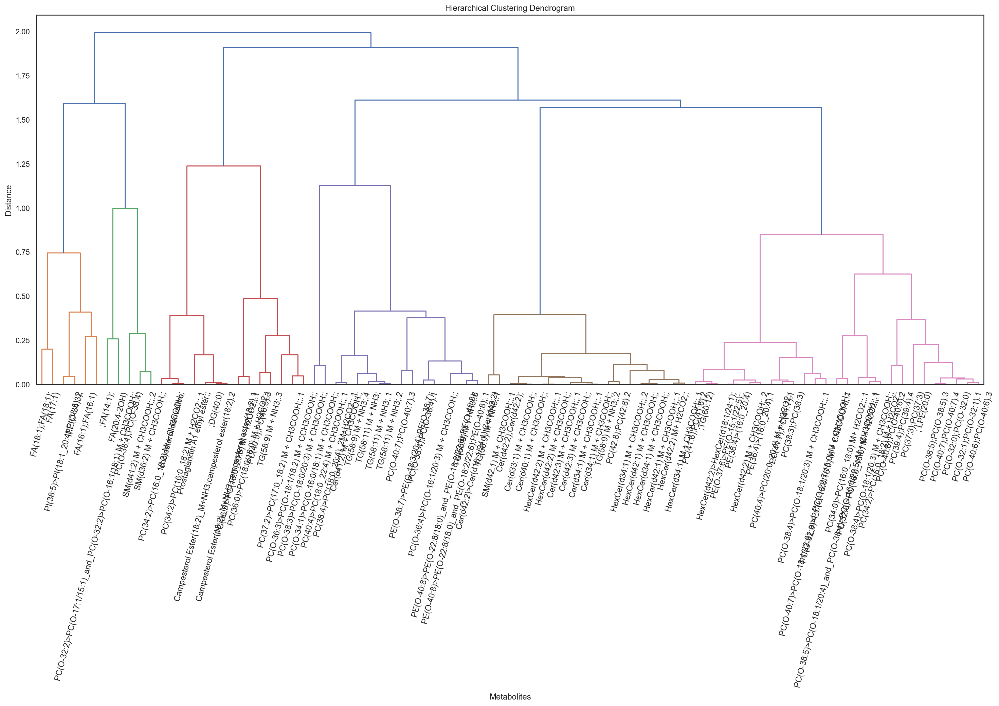

In [33]:
# generate dataframe that contains log2 fold change of metabolites
fc_upload = timepoint_fold_change(sig_features, stages, 'normalize to control')

# plot dendogram
hierarchical_clustering(sig_features, fc_upload)

In [34]:
def print_clusters(df, k, plot=False):
    '''
    Function plots the trajectory of all metabolic clusters
    Input
    df: Pandas dataframe output from `timepoint_fold_change`function, 
    containing log2 fold change of metabolites
    k: k Number of clusters I'd like to extract
    
    Output
    A plots of all clusters if plot==False, else a list of dataframes containing metabolites identity.  
    
    '''
    DF_list =[] # A list to store dataframes for each clusters
    # set the column 'features' as index in the incoming dataframe.
    df = df.set_index('features')
    
    # computing the linkage, hierarchical/agglomerative clustering
    # Link: https://docs.scipy.org/doc/scipy/reference/generated/scipy.cluster.hierarchy.linkage.html#scipy.cluster.hierarchy.linkage
    # Z: The hierarchical clustering encoded with the matrix returned by the linkage function
    Z = linkage(df, 
                metric='correlation', 
                method='complete') #metric to try: euclidean or correlation
    
    #fcluster link: https://docs.scipy.org/doc/scipy/reference/generated/scipy.cluster.hierarchy.fcluster.html
    results = fcluster(Z, k, criterion='maxclust')

    # check the results
    # convert numpy.ndarray data structure (results) to pandas series
    # The series has an index with the corresponding cluster number
    s = pd.Series(results)
    
    # clusters = unique elements in the series.
    clusters = s.unique()

    for c in clusters:
        # a pandas core indexes data structure that include the cluster indeces
        # cluster indeces is the indeces of features that belong to the same clusters.
        cluster_indeces = s[s==c].index
        
        # plot header Cluster _ number of entries _
        # len of cluster_indeces gives the number of entires in cluster c. 
        #print("Cluster %d number of entries %d" % (c, len(cluster_indeces)))
        if plot == True:
            # len of cluster_indeces gives the number of entires in cluster c. 
            print("Cluster %d number of entries %d" % (c, len(cluster_indeces)))
            #return df.T.iloc[:,cluster_indeces].hvplot.line()
            df.T.iloc[:,cluster_indeces].plot()
            # place legend outside plot to prevent blocking the figure. 
            plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left');
            plt.show()
        else:
            # a dataframe containing the data for a particular cluster.
            pap = df.T.iloc[:,cluster_indeces]
            # include a new column in the dataframe and populate with cluster no. 
            pap['cluster'] = c
            # append current dataframe to DF_list[]: a list of dataframe.
            DF_list.append(pap)
            
    return DF_list

***`print clusters` with plots***

Cluster 10 number of entries 13


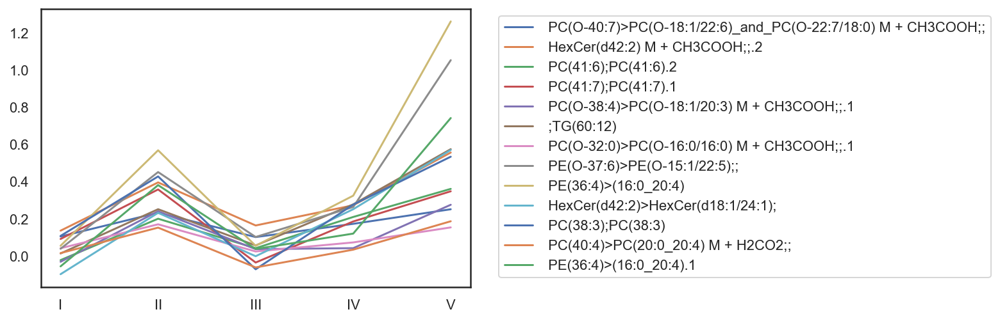

Cluster 4 number of entries 3


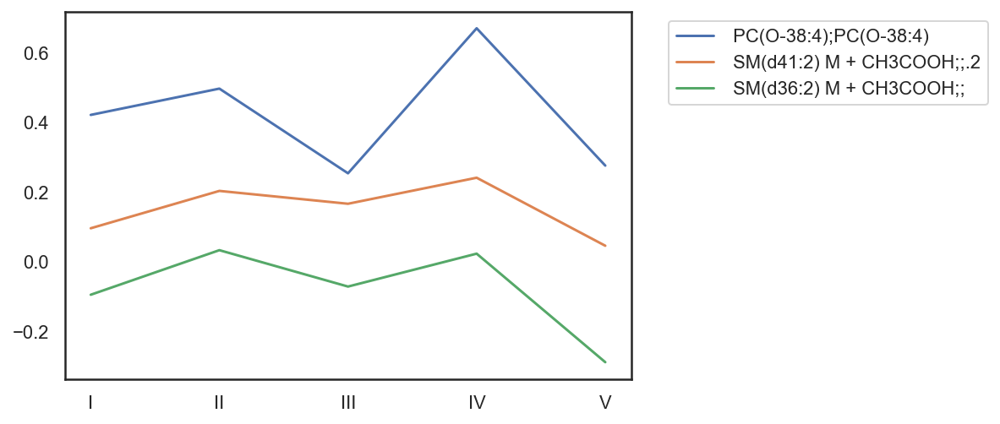

Cluster 8 number of entries 14


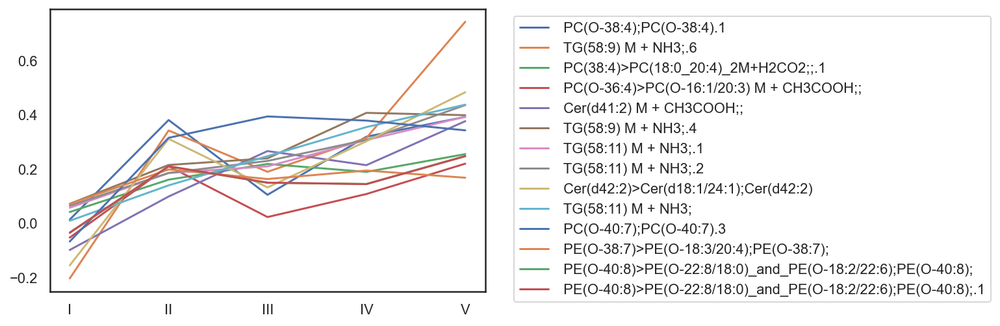

Cluster 11 number of entries 5


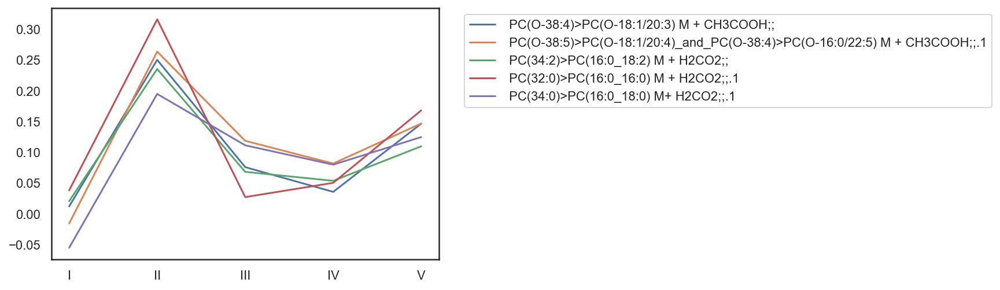

Cluster 9 number of entries 19


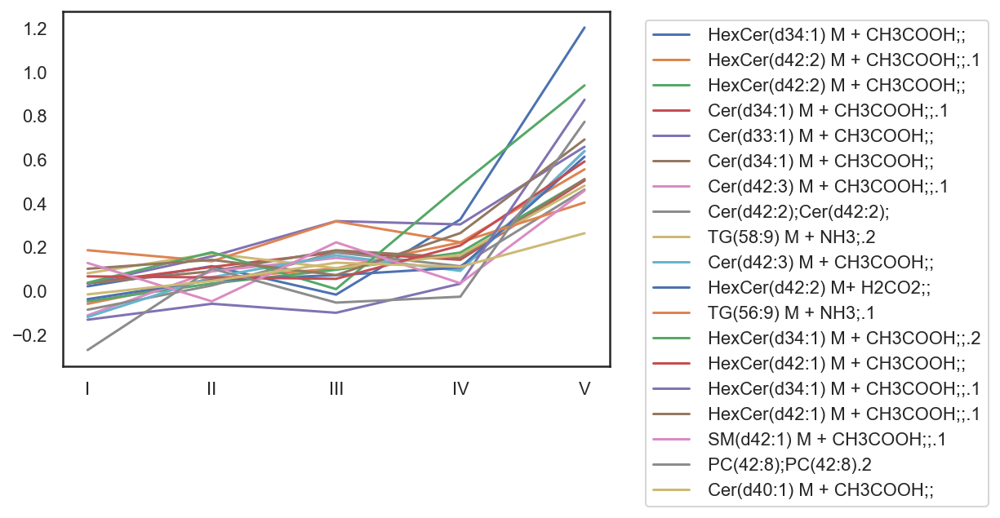

Cluster 12 number of entries 9


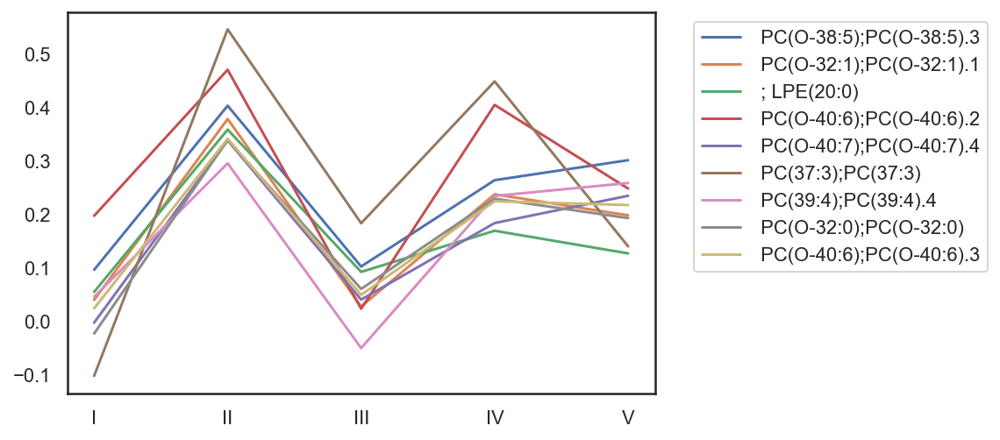

Cluster 5 number of entries 7


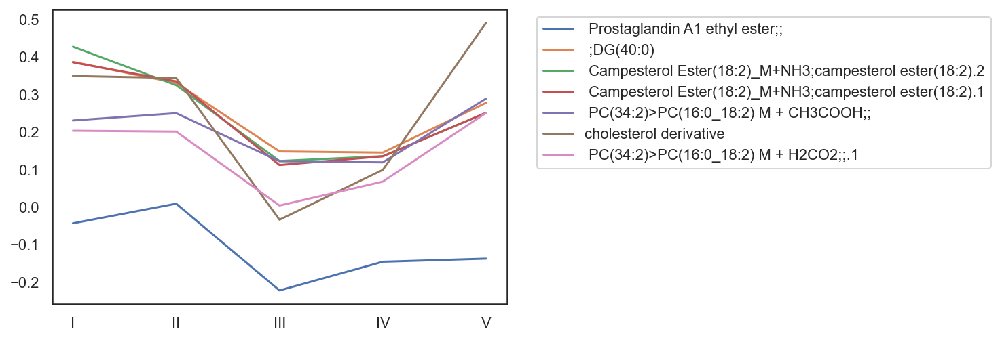

Cluster 3 number of entries 2


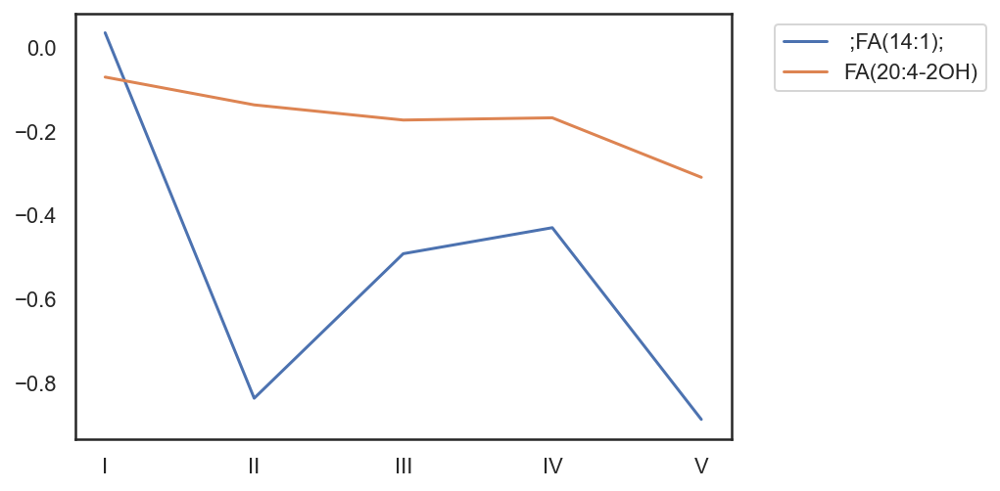

Cluster 6 number of entries 7


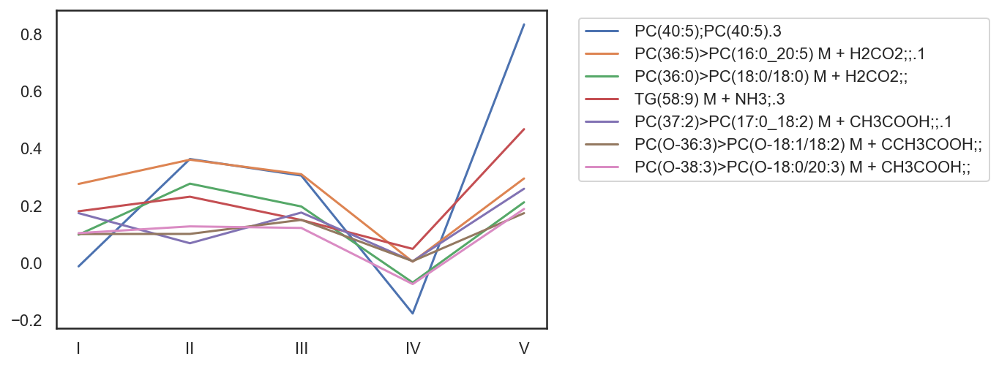

Cluster 2 number of entries 4


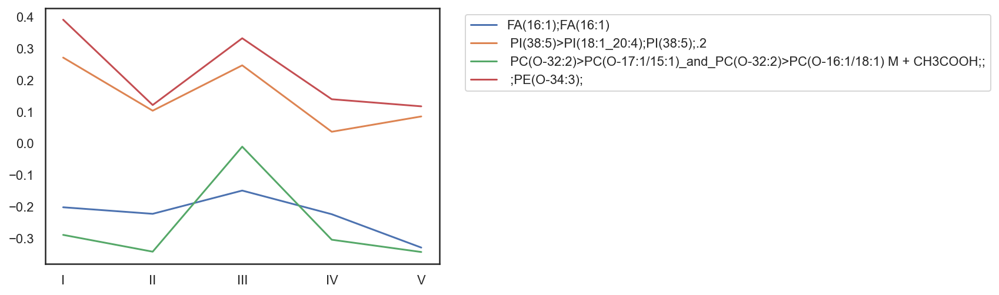

Cluster 1 number of entries 2


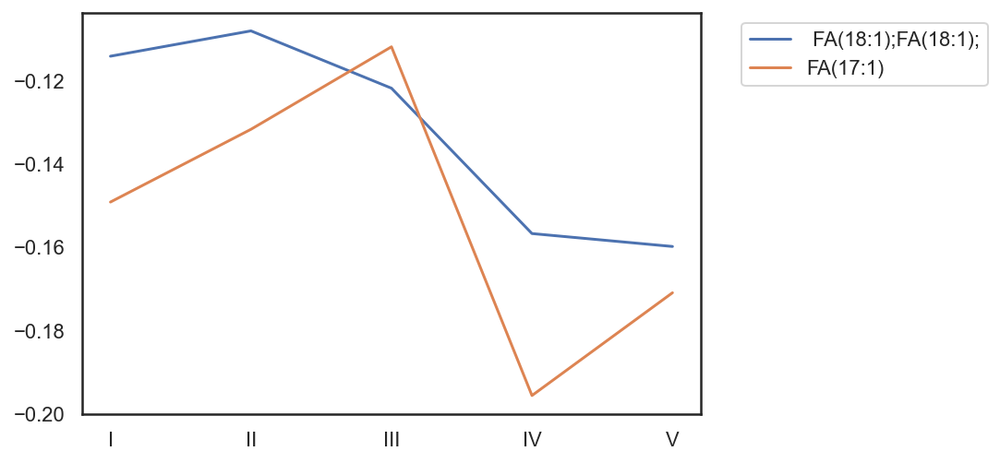

Cluster 7 number of entries 2


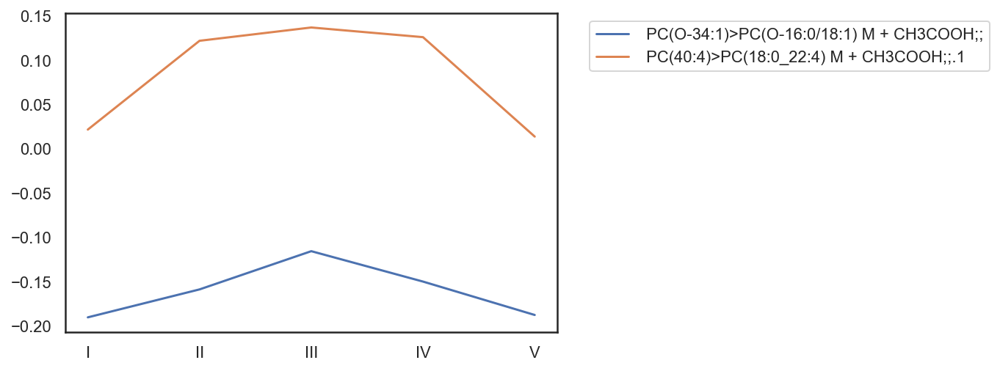

In [35]:
# generate dataframe that contains log2 fold change of metabolites
fc_upload = timepoint_fold_change(sig_features, stages, 'normalize to control')

# plot dendogram
metabolic_clusters = print_clusters(fc_upload, 12, plot=True)

***`print clusters` returns list for dataframe containing clusters***

In [36]:
# generate dataframe that contains log2 fold change of metabolites
fc_upload = timepoint_fold_change(sig_features, stages, 'normalize to control')

# plot dendogram
metabolic_clusters = print_clusters(fc_upload, 12, plot=False)
len(metabolic_clusters)

12

**For the 12 clusters classification for the `sig_features` clustering:** the following are potentially interesting clusters: 

- [0] = cluster 10
- [3] = cluster 11
- [4] = cluster 9
- [5] = cluster 12

### [Go to Table of Contents](#0) <br>

### 3.4 Selected lipidomic clusters identified _via_ HCA.
<a id='3.4'></a>

In [37]:
import plotly.express as px

In [38]:
def printsub_clusters(cluster_order_number):
    '''
    Function: this function generates line plots and heatmap summarizing
    longitudinal trend of data within a particular cluster. 
    
    Input:
    cluster_order_number = integer
    This is the order of the cluster (to be replotted) in the 
    `print_clusters` function output.
    
    Output: 
    fig1>an holoview lineplot, 
    fig2>an holoview heatmap, 
    fig3>a plotly heatmap. 
    fig2 and fig3 are essentially the same output. However fig3
    is the version of the figure saved. 
    '''
    
    metabolic_cluster = metabolic_clusters[cluster_order_number]
    
    # get the first value in cluster, this is the cluster ID. 
    clus = metabolic_cluster['cluster'][0]
    
    # plot the graph and use cluster number as title. 
    
    fig1 = metabolic_cluster.drop(['cluster'], axis=1).hvplot.line(legend = False, 
                                                                   width=500, 
                                                                   height=400,
                                                                   fontsize = '7pt', 
                                                                   title = 'cluster %d' % clus)
    
    
    fig2 = metabolic_cluster.drop(['cluster'], axis=1).T.hvplot.heatmap(width=700, 
                                                                        height=500,
                                                                        colorbar='Log2',
                                               title = 'Longitudinal trend of cluster x', 
                                               cmap= ["#75968f", "#a5bab7", "#c9d9d3", "#e2e2e2", "#dfccce", "#ddb7b1", "#cc7878", "#933b41", "#550b1d"])
    
    fig3 = px.imshow(metabolic_cluster.drop(['cluster'], axis=1).T, 
                     color_continuous_scale='RdBu_r', 
                     origin='lower')
    
    return fig1, fig2, fig3

### Cluster 10 (order = 0) A
### Cluster 11 (order = 3) B
### Cluster 9 (order = 4) D
### Cluster 12 (order = 5) C

Run the _bloody_ function: 

In [39]:
plot1, plot2, plot3 = printsub_clusters(4)

In [40]:
plot1

:NdOverlay   [features]
   :Curve   [index]   (value)

In [41]:
# A more aesthetic pleasing interactive heatmap.
# see graph below for alternative.
plot2

:HeatMap   [columns,index]   (value)

In [42]:
plot3

export lineplot as `svg`.

In [43]:
#plot = total_fold_change(features, 'All annotated features - all timepoints combined')
#hv.extension('matplotlib')
#hvplot.save(plot1, 'plot1.svg', fmt='svg')
#hv.extension('bokeh')

export heatmap as `svg`.

In [44]:
#save figure
#plot3.write_image("plot3.svg", engine="kaleido")

In [45]:
overlap_metabolites

[' Prostaglandin A1 ethyl ester;;',
 ' PC(O-40:7);PC(O-40:7).3',
 ' Cer(d41:2) M + CH3COOH;;',
 ' Cer(d33:1) M + CH3COOH;;']

### [Go to Table of Contents](#0) <br>

### 3.5 Correlation network graphs for metabolic clusters.
<a id='3.5'></a>

In [46]:
import plotly as py
import plotly.graph_objs as go
import networkx as nx

**For the 12 clusters classification for the `sig_features` clustering, the following are the potentially interesting clusters:** 

- [0] = cluster 10
- [3] = cluster 11
- [4] = cluster 9
- [5] = cluster 12

In [47]:
def networkGraph(Dataframe, corr, color='YlGnBu', title='Interactive Network Graph'):
    
    '''
    FUNCTION: 
    An interative network graph for correlation network ploted by plotly  
    
    DEPENDENCY: 
    networkx, plotly, plotly.graph_objs
    import plotly as py
    import plotly.graph_objs as go
    import networkx as nx
    
    INPUTS: 
    DataFrame = A pandas dataframe containing only metabolites concentrations or relevant meta-data
    corr = Numeric. the cut off correlation value
    color =  String. 
    # colorscale options
    #'Greys' | 'YlGnBu' | 'Greens' | 'YlOrRd' | 'Bluered' | 'RdBu' |
    #'Reds' | 'Blues' | 'Picnic' | 'Rainbow' | 'Portland' | 'Jet' |
    #'Hot' | 'Blackbody' | 'Earth' | 'Electric' | 'Viridis' |
    title = String. The title of the graph. default is 'Interactive Network Graph'
    
    OUTPUT: 
    Interactive Network graph
    
    '''
    #metabolic_cluster = metabolic_clusters[cluster_order_number]
    
    py.offline.init_notebook_mode(connected=True) # To run graph in notebook. 
    
    links = Dataframe.corr().stack().reset_index()
    #links = fused_df.drop(['Groups_x', 'Groups_y'], axis=1).corr().stack().reset_index()
    links.columns = ['var1', 'var2','value']
    links_filtered=links.loc[(links['value'] > corr) & (links['var1'] != links['var2'])]
    # Build your graph
    Graph=nx.from_pandas_edgelist(links_filtered, 'var1', 'var2')
    
    '''Get Node Position'''
    #get a x,y position for each node
    pos = nx.layout.spring_layout(Graph)
    for n, p in pos.items():
        Graph.nodes[n]['pos'] = p
        
    '''Create Edges'''
    edge_trace = go.Scatter(
        x=[],
        y=[],
        line=dict(width=0.5,color='#888'),
        hoverinfo='none',
        mode='lines')
    for edge in Graph.edges():
        x0, y0 = Graph.nodes[edge[0]]['pos']
        x1, y1 = Graph.nodes[edge[1]]['pos']
        edge_trace['x'] += tuple([x0, x1, None])
        edge_trace['y'] += tuple([y0, y1, None])
        
    node_trace = go.Scatter(
        x=[],
        y=[],
        text=[],
        mode='markers',
        hoverinfo='text',
        marker=dict(
            showscale=True,
            # colorscale options
            #'Greys' | 'YlGnBu' | 'Greens' | 'YlOrRd' | 'Bluered' | 'RdBu' |
            #'Reds' | 'Blues' | 'Picnic' | 'Rainbow' | 'Portland' | 'Jet' |
            #'Hot' | 'Blackbody' | 'Earth' | 'Electric' | 'Viridis' |
            colorscale=color,
            reversescale=True,
            color=[],
            size=10,
            colorbar=dict(
                thickness=15,
                title='Node Connections',
                xanchor='left',
                titleside='right'
            ),
            line=dict(width=2)))
    for node in Graph.nodes():
        x, y = Graph.nodes[node]['pos']
        node_trace['x'] += tuple([x])
        node_trace['y'] += tuple([y])
    
    '''Color Node Points and Hover Text'''
    for node, adjacencies in enumerate(Graph.adjacency()):
        node_trace['marker']['color']+=tuple([len(adjacencies[1])])
        #node_info = '# of connections: '+str(len(adjacencies[1]))
        node_info = str(adjacencies[0])#Hover Text
        node_trace['text']+=tuple([node_info])
        
    '''Network Graph'''
    fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                 title=title,
                 titlefont=dict(size=16),
                 showlegend=False,
                 hovermode='closest',
                 margin=dict(b=20,l=5,r=5,t=40),
                 annotations=[ dict(
                     text="Hover over graph to see annotations",
                     showarrow=False,
                     xref="paper", yref="paper",
                     x=0.005, y=-0.002 ) ],
                 xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                 yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)))

    return fig
    #return py.offline.iplot(fig)

**For the 12 clusters classification for the `sig_features` clustering, the following are the potentially interesting clusters:** 

`Cluster 10 (order = 0) A` <br>
`Cluster 11 (order = 3) B` <br>
`Cluster 9 (order = 4) D` <br>
`Cluster 12 (order = 5) C` <br>

In [48]:
#plot = networkGraph(df[metabolic_clusters[0].columns], 0.5, 'Viridis')
plot = networkGraph(df[metabolic_clusters[0].drop(['cluster'], axis=1).columns], 0.5, 'Viridis')
py.offline.iplot(plot)

In [49]:
#plot = networkGraph(df[metabolic_clusters[0].columns], 0.5, 'Viridis')
plot = networkGraph(df[metabolic_clusters[0].drop(['cluster'], axis=1).columns], 0.5, 'Viridis')
py.offline.iplot(plot)

In [50]:
#save figure
#plot.write_image("plot.svg", engine="kaleido")

**List metabolites in metabolic clusters**

In [51]:
# Cluster A
metabolic_clusters[0].columns

Index([' PC(O-40:7)>PC(O-18:1/22:6)_and_PC(O-22:7/18:0) M + CH3COOH;;',
       ' HexCer(d42:2) M + CH3COOH;;.2', ' PC(41:6);PC(41:6).2',
       ' PC(41:7);PC(41:7).1', ' PC(O-38:4)>PC(O-18:1/20:3) M + CH3COOH;;.1',
       ' ;TG(60:12)', ' PC(O-32:0)>PC(O-16:0/16:0) M + CH3COOH;;.1',
       ' PE(O-37:6)>PE(O-15:1/22:5);;', ' PE(36:4)>(16:0_20:4)',
       ' HexCer(d42:2)>HexCer(d18:1/24:1);', ' PC(38:3);PC(38:3)',
       ' PC(40:4)>PC(20:0_20:4) M + H2CO2;;', ' PE(36:4)>(16:0_20:4).1',
       'cluster'],
      dtype='object', name='features')

In [52]:
# Cluster B
metabolic_clusters[3].columns

Index([' PC(O-38:4)>PC(O-18:1/20:3) M + CH3COOH;;',
       ' PC(O-38:5)>PC(O-18:1/20:4)_and_PC(O-38:4)>PC(O-16:0/22:5) M + CH3COOH;;.1',
       ' PC(34:2)>PC(16:0_18:2) M + H2CO2;;',
       ' PC(32:0)>PC(16:0_16:0) M + H2CO2;;.1',
       ' PC(34:0)>PC(16:0_18:0) M+ H2CO2;;.1', 'cluster'],
      dtype='object', name='features')

In [53]:
# Cluster C
metabolic_clusters[5].columns

Index([' PC(O-38:5);PC(O-38:5).3', ' PC(O-32:1);PC(O-32:1).1', ' ; LPE(20:0)',
       ' PC(O-40:6);PC(O-40:6).2', ' PC(O-40:7);PC(O-40:7).4',
       ' PC(37:3);PC(37:3)', ' PC(39:4);PC(39:4).4', ' PC(O-32:0);PC(O-32:0)',
       ' PC(O-40:6);PC(O-40:6).3', 'cluster'],
      dtype='object', name='features')

In [54]:
# Cluster D
metabolic_clusters[4].columns

Index([' HexCer(d34:1) M + CH3COOH;;', ' HexCer(d42:2) M + CH3COOH;;.1',
       ' HexCer(d42:2) M + CH3COOH;;', ' Cer(d34:1) M + CH3COOH;;.1',
       ' Cer(d33:1) M + CH3COOH;;', ' Cer(d34:1) M + CH3COOH;;',
       ' Cer(d42:3) M + CH3COOH;;.1', ' Cer(d42:2);Cer(d42:2);',
       ' TG(58:9) M + NH3;.2', ' Cer(d42:3) M + CH3COOH;;',
       ' HexCer(d42:2) M+ H2CO2;;', ' TG(56:9) M + NH3;.1',
       ' HexCer(d34:1) M + CH3COOH;;.2', ' HexCer(d42:1) M + CH3COOH;;',
       ' HexCer(d34:1) M + CH3COOH;;.1', ' HexCer(d42:1) M + CH3COOH;;.1',
       ' SM(d42:1) M + CH3COOH;;.1', ' PC(42:8);PC(42:8).2',
       ' Cer(d40:1) M + CH3COOH;;', 'cluster'],
      dtype='object', name='features')

In [55]:
#Import lipid IDs
lipid_compds = pd.read_excel('data/lipid_compounds_annotated_ids.xlsx')
#lipid_compds = lipid_compds.iloc[:, 1:]

In [62]:
# Identify lipid IDs. 
clusterA_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(metabolic_clusters[0].columns)]
#clusterA_ID.to_excel("clusterA_ID.xlsx")
clusterA_ID.shape

(13, 3)

In [63]:
# Identify lipid IDs. 
clusterB_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(metabolic_clusters[3].columns)]
#clusterB_ID.to_excel("clusterB_ID.xlsx")
clusterB_ID.shape

(5, 3)

In [64]:
# Identify lipid IDs. 
clusterC_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(metabolic_clusters[5].columns)]
#clusterC_ID.to_excel("clusterC_ID.xlsx")
clusterC_ID.shape

(9, 3)

In [65]:
# Identify lipid IDs. 
clusterD_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(metabolic_clusters[4].columns)]
#clusterD_ID.to_excel("clusterD_ID.xlsx")
clusterD_ID.shape

(19, 3)

### For ML discriminative lipids

In [72]:
stage1 = [' ;3-hydroxyphenyl-valerate;3-hydroxyphenyl-valerate,', ' ;PE(O-34:3);',
       ' PE(O-36:6)>PE(O-16:1/20:5);;.1',
       ' PC(38:6)>PC(16:0_22:6)_and_PC(18:0_20:6) M + H2CO2;;',
       ' PC(37:2)>PC(17:0_18:2) M + CH3COOH;;.2']

In [73]:
stage1_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(stage1)]
#stage1_ID.to_excel("stage1_ID.xlsx")

In [75]:
stage2 = [' PC(O-38:4)>PC(O-18:1/20:3) M + CH3COOH;;',
       ' PC(34:2)>PC(16:0_18:2) M + H2CO2;;', ' SM(d34:2) M + CH3COOH;;',
       ' PC(O-40:6);PC(O-40:6).2', ' HexCer(d40:0-OH) M + CH3COOH;;',
       ' ;FA(18:3)', ' SM(d42:2) M + CH3COOH;;.1', ' SM(d42:2) M + CH3COOH;;',
       ' HexCer(d40:1-OH)_M+CH3COOH;;', ' PE(39:6)>PE(17:0_22:6)',
       ' PC(O-32:0)>PC(O-16:0/16:0) M + CH3COOH;;.1',
       ' PC(O-36:3)>PC(O-18:1/18:2) M + CCH3COOH;;.1',
       ' PC(O-36:4)>PC(O-16:1/20:3) M + CH3COOH;;',
       ' PC(O-38:4)>PC(O-18:1/20:3) M + CH3COOH;;.1',
       ' PC(O-38:6)>PC(O-16:1/22:5) M + CH3COOH;;',
       ' PC(O-40:7)>PC(O-18:1/22:6)_and_PC(O-22:7/18:0) M + CH3COOH;;',
       ' PC(40:4)>PC(18:0_22:4) M + CH3COOH;;.1',
       ' PC(34:3)>PC(16:0_18:3) M + CH3COOH',
       ' PC(36:4)>PC(18:2/18:2) M + CH3COOH;;',
       ' PC(36:5)>PC(16:0_20:5) M + H2CO2;;',
       ' PC(36:5)>PC(16:1_20:4) M + H2CO2;;',
       ' PC(38:4)>PC(18:0_20:4)_2M+H2CO2;;',
       ' PC(38:5)>PC(18:1_20:4)_and_PC(38:5)>PC(16:0_22:5) M + CH3COOH;;',
       ' PC(37:3);PC(37:3)', ' ;FA(26:1);FA(26:1)']

In [76]:
stage2_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(stage2)]
#stage2_ID.to_excel("stage2_ID.xlsx")

In [77]:
stage3 = [' 6-methyl-1-(2-methylphenyl)-3-propylfuro[3,2-d]pyrimidine-2,4(1H,3H)-dione;6-methyl-1-(2-methylphenyl)-3-propylfuro[3,2-d]pyrimidine-2,4(1H,3H)-dione',
       ' PC(37:6);PC(37:6)', ' Prostaglandin A1 ethyl ester;;', ' FA(18:2)',
       ' PI(38:5)>PI(18:1_20:4);PI(38:5);.2',
       ' PI(38:5)>PI(18:1_20:4);PI(38:5);', ' Cer(d45:1) M + CH3COOH;;',
       ' PE(O-36:2)>PE(O-18:0/18:2);PE(O-36:2);',
       ' PC(38:4)>PC(18:0_20:4) M + H2CO2;;.1', ' Cer(d41:2) M + CH3COOH;;',
       ' PC(40:4)>PC(18:0_22:4) M + CH3COOH;;.1', ' Cer(d33:1) M + CH3COOH;;',
       ' PC(O-38:6);PC(O-38:6).2', ' HexCer(d38:0-OH) M + CH3COOH;;.1',
       ' HexCer(d40:0)_M+CH3COOH;HexCer(t42:0-OH);.1',
       ' PC(36:4)>PC(16:0_20:4) M + CH3COOH;;.1',
       ' PC(36:0)>PC(18:0/18:0) M + H2CO2;;',
       ' TG(54:3)>TG(18:0_18:1_18:2)_and_TG(18:1/18:1/18:1)_and_TG(16:0_18:2_20:1) M + NH3;']

In [78]:
stage3_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(stage3)]
#stage3_ID.to_excel("stage3_ID.xlsx")

In [82]:
stage4 = [' PC(O-38:4);PC(O-38:4)', ' PC(O-32:0);PC(O-32:0)',
       ' TG(58:11) M + NH3;', ' PC(O-38:4);PC(O-38:4).1',
       ' PC(O-40:7);PC(O-40:7).3',
       ' PC(O-40:7)>PC(O-18:1/22:6)_and_PC(O-22:7/18:0) M + CH3COOH;;',
       ' PC(O-35:5)>PC(O-15:1/20:4) M + CH3COOH;;',
       ' PC(40:5)>PC(18:0_22:5) M + CH3COOH;;', ' ;FA(20:1-OH);FA(20:1-OH)',
       ' ;FA(20:2-2OH);FA(20:2-2OH)', ' SM(d35:1);SM(d35:1)',
       ' HexCer(d34:1) M + CH3COOH;;.2',
       ' SM(t39:0)_or_SM(d39:0-OH) M + CH3COOH;;', ' PC(37:3);PC(37:3)',
       ' PC(39:4);PC(39:4).2', ' ;PC(O-37:5)', ' PC(37:6);PC(37:6).2',
       ' Cer(d45:1) M + CH3COOH;;', ' PI(38:5)>PI(18:1_20:4);PI(38:5);.1',
       ' Cer(d33:1) M + CH3COOH;;', ' PC(37:4);PC(37:4)',
       ' PC(40:4)>PC(18:0_22:4) M + CH3COOH;;.1',
       ' ;FA(20:1-2OH);FA(20:1-2OH)', ' SM(d41:2) M + CH3COOH;;.2']

In [83]:
stage4_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(stage4)]
#stage4_ID.to_excel("stage4_ID.xlsx")

In [84]:
stage5 = [' HexCer(d34:1) M + CH3COOH;;', ' PC(40:5);PC(40:5).3',
       ' SM(d37:1) M + CH3COOH;;.1', ' SM(d36:2) M + CH3COOH;;',
       ' PC(O-40:7)>PC(O-18:1/22:6)_and_PC(O-22:7/18:0) M + CH3COOH;;',
       ' PC(O-40:5)>PC(O-18:1/22:4) M + CH3COOH;;', ' ;TG(60:12)',
       ' PE(O-42:7)>PE(O-20:1/22:6)', ' TG(58:9) M + NH3;.6',
       ' TG(58:9) M + NH3;.2', ' PC(O-38:4);PC(O-38:4).1',
       ' SM(d38:1) M + CH3COOH;;', ' Cer(d42:2);Cer(d42:2);',
       ' TG(58:9) M + NH3;.3', ' PC(O-38:4)>PC(O-18:1/20:3) M + CH3COOH;;.1',
       ' PC(37:2);PC(37:2)',
       ' PC(O-40:7)>PC(O-18:1/22:6)_and_PC(O-22:7/18:0) M + CH3COOH;;.1',
       ' SM(d41:1) M + CH3COOH;;', ' ;TG(58:8)',
       ' PC(O-38:6)>PC(O-16:1/22:5) M + CH3COOH;;',
       ' LPC(20:5)>LPC(20:5/0:0)_and_LPC(0:0/20:5) M+ H2CO2;;',
       ' PE(O-42:4)>PE(O-18:2/24:2);;', ' PC(38:3);PC(38:3)',
       ' PC(42:6);PC(42:6)', ' ;PE(P-40:4);', ' PC(O-38:5);PC(O-38:5).3',
       'cholesterol derivative ', ' PI(36:4)>PI(16:0_20:4).1', ' ;LPE(18:1);',
       ' TG(58:8)>TG(18:0_20:4_20:4)_and_TG(58:8)>TG(18:0_18:2_22:6);',
       ' SM(d36:2);SM(d36:2)', ' SM(d38:4);SM(d38:4)',
       ' PC(O-40:7);PC(O-40:7).3',
       ' LPC(20:4)>LPC(20:4/0:0)_and_LPC(0:0/20:4) M + H2CO2;;',
       ' PC(40:4);PC(40:4).1', 'FA(24:1);FA(24:1)',
       ' PC(30:0)>PC(14:0_16:0) M + CH3COOH;;', ' ;TG(58:10)',
       ' PE(O-40:4)>PE(O-18:0/22:4);PE(O-40:4);.1',
       ' PC(O-40:7)>PC(O-18:1/22:6)_and_PC(O-22:7/18:0) M + CH3COOH;;.2',
       ' ;TG(60:10)', ' TG(50:1)>TG(16:0_16:0_18:1)_M+NH3;']

In [85]:
stage5_ID = lipid_compds.loc[lipid_compds['Lipids'].isin(stage5)]
#stage5_ID.to_excel("stage5_ID.xlsx")

### [Go to Table of Contents](#0) <br>

### 3.6 HCA for lipidomic trajectories: DKO stages _vs_ DKO stage I
<a id='3.6'></a>

### Dendogram

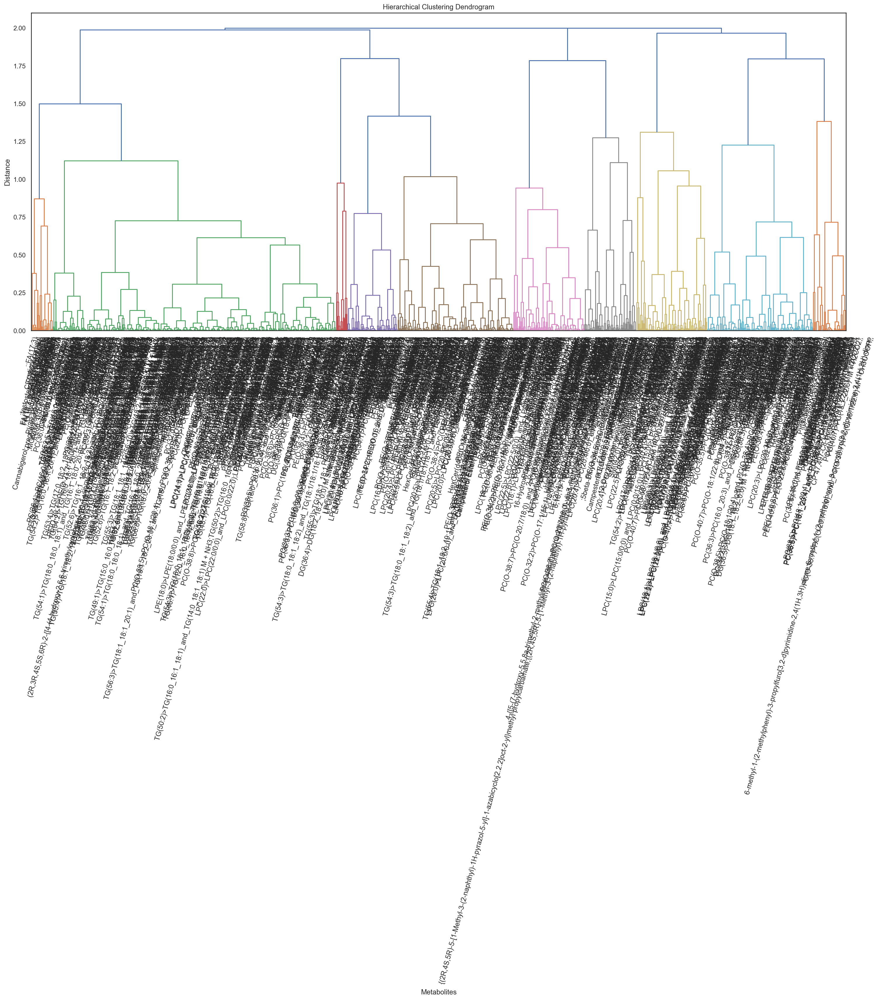

In [51]:
# generate dataframe that contains log2 fold change of metabolites
fc_upload = timepoint_fold_change(features, stages, 'normalize to timepoint1')

# plot dendogram
hierarchical_clustering(features, fc_upload)

### Print Clusters

Cluster 6 number of entries 93


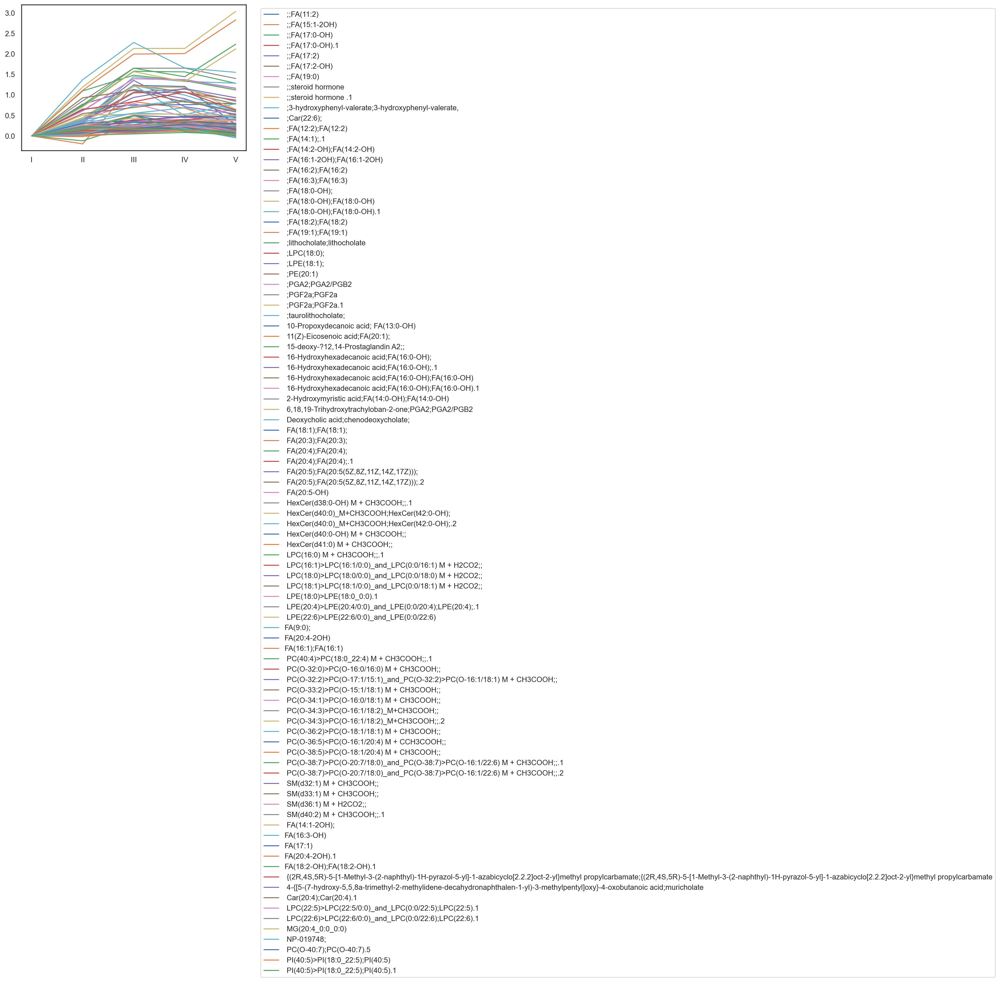

Cluster 10 number of entries 44


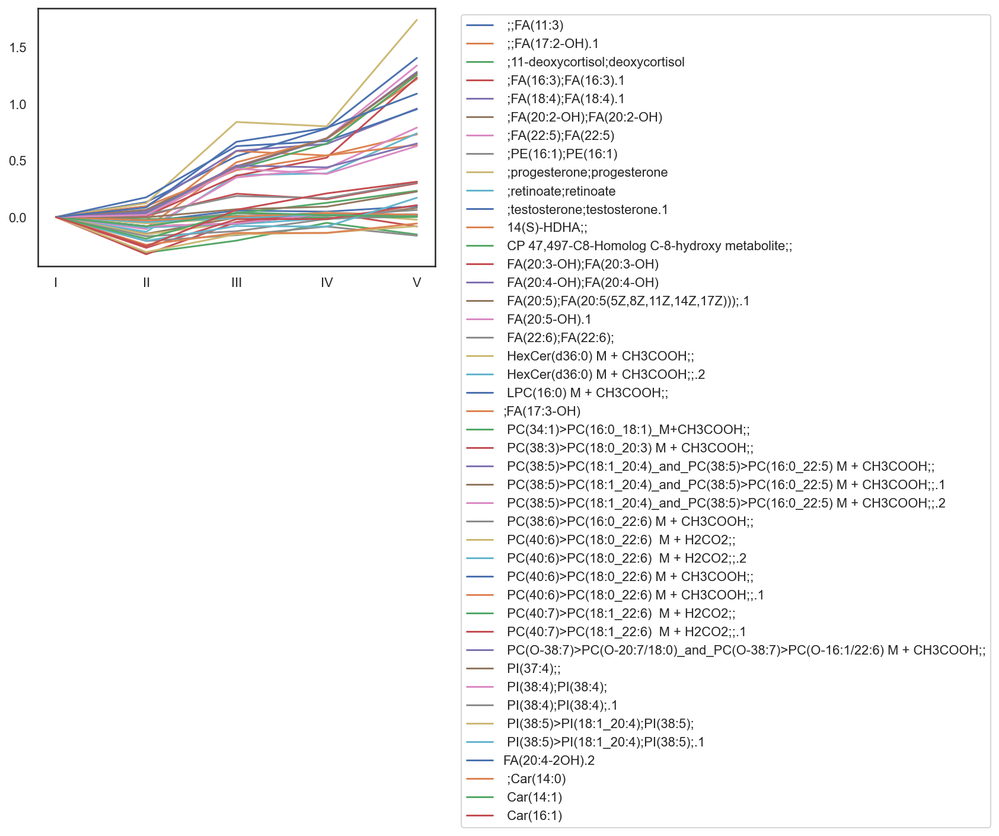

Cluster 5 number of entries 152


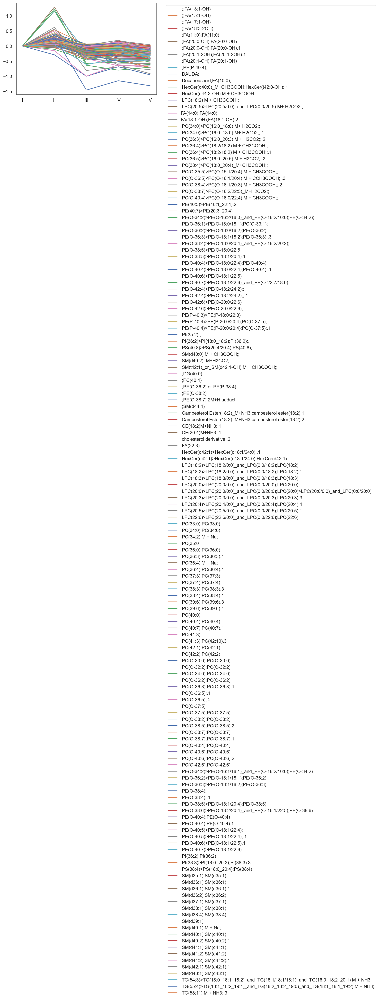

Cluster 7 number of entries 68


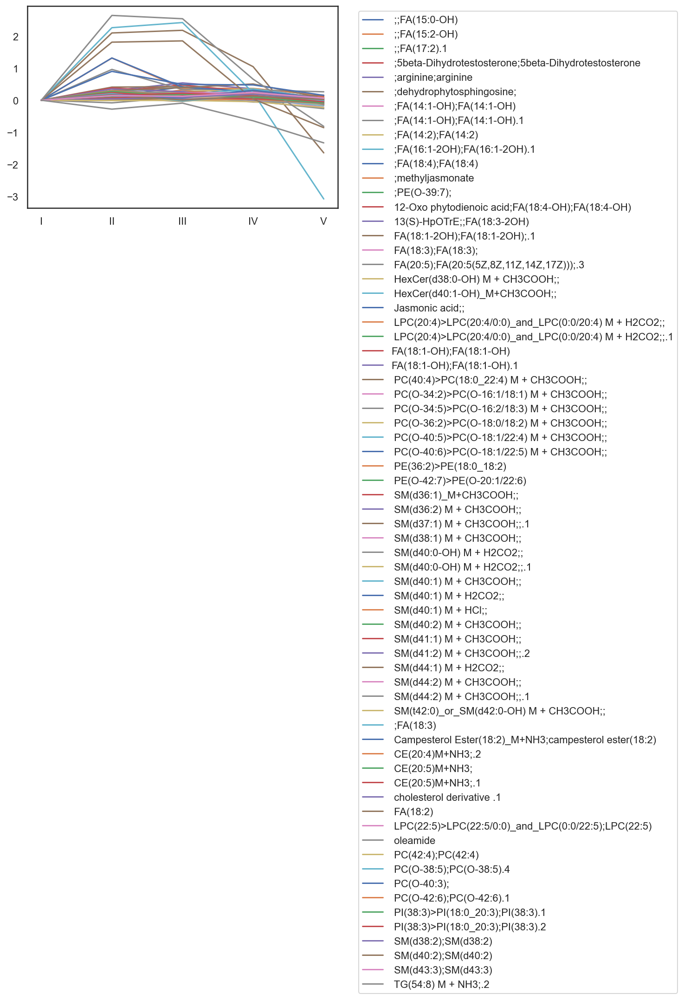

Cluster 2 number of entries 372


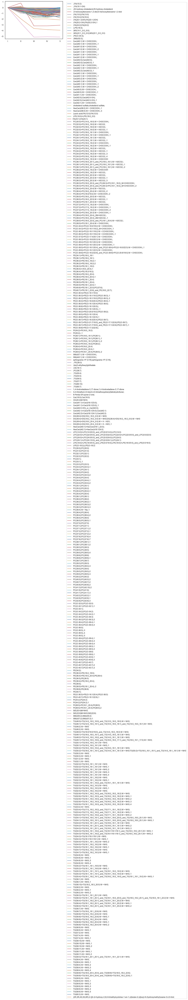

Cluster 8 number of entries 93


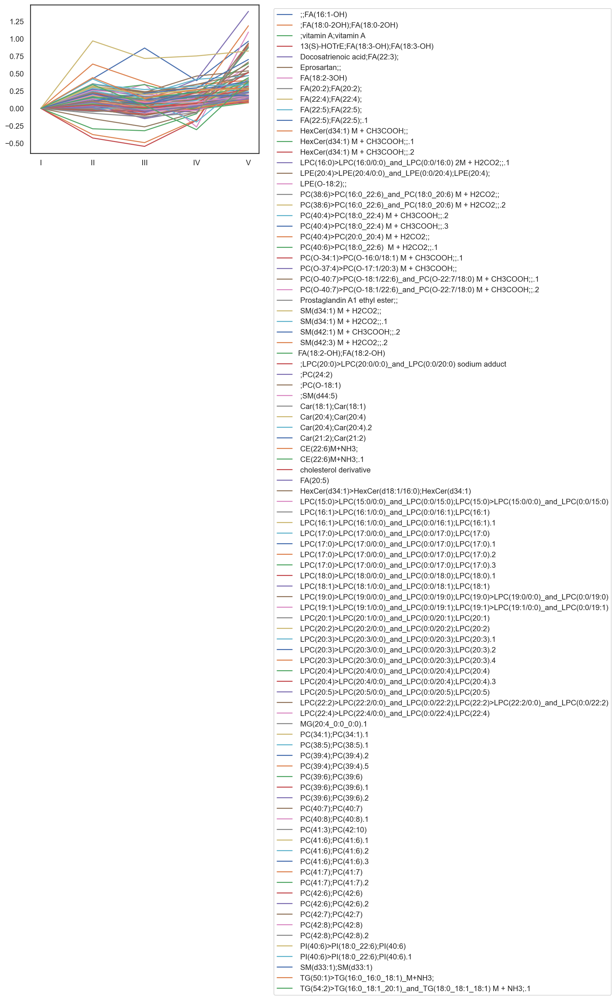

Cluster 1 number of entries 28


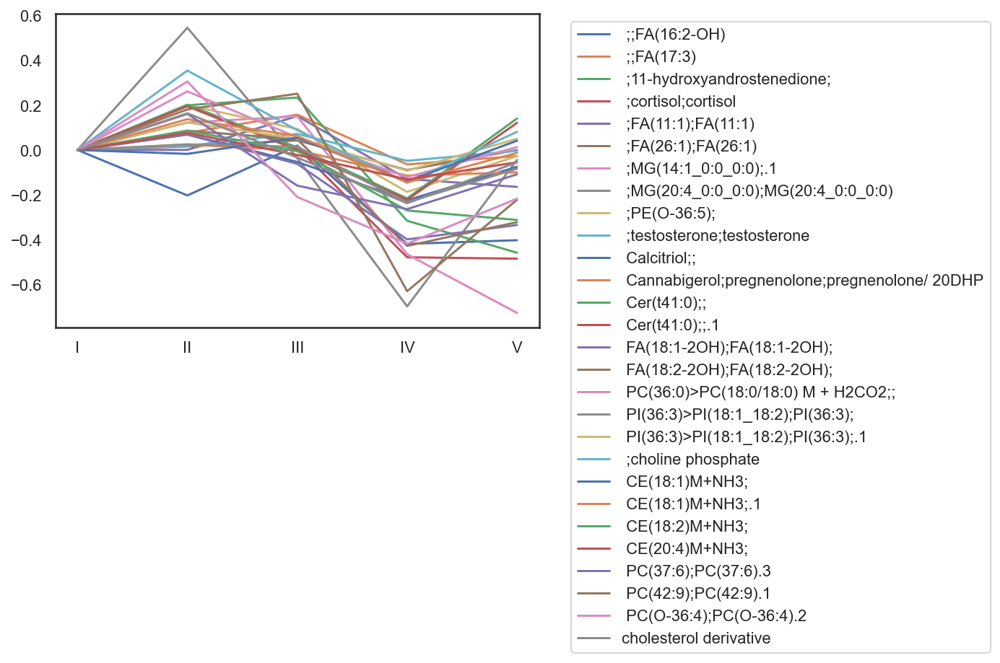

Cluster 3 number of entries 15


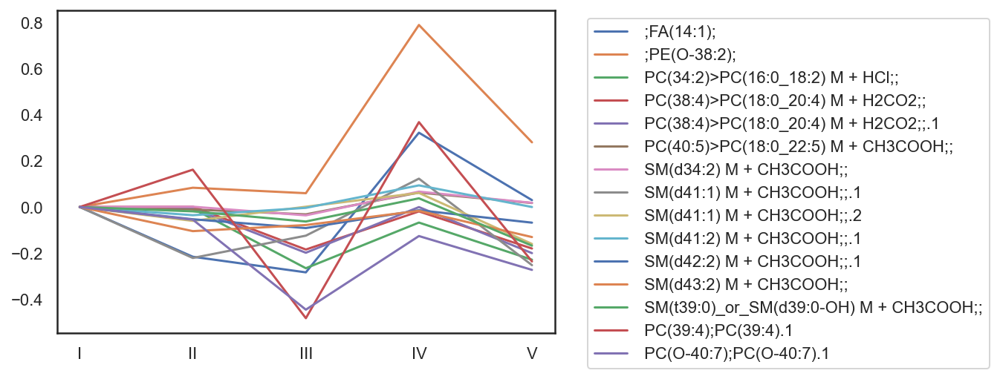

Cluster 9 number of entries 139


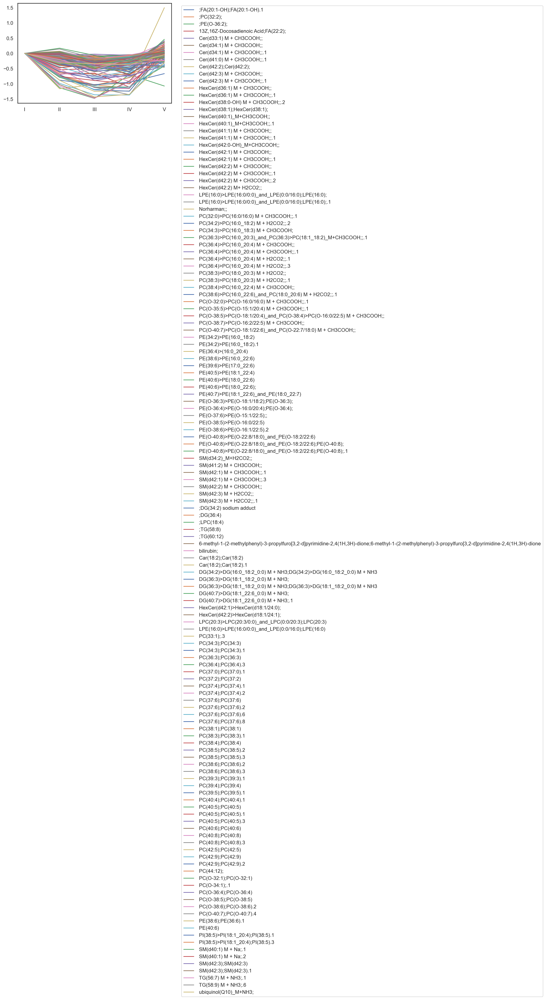

Cluster 4 number of entries 66


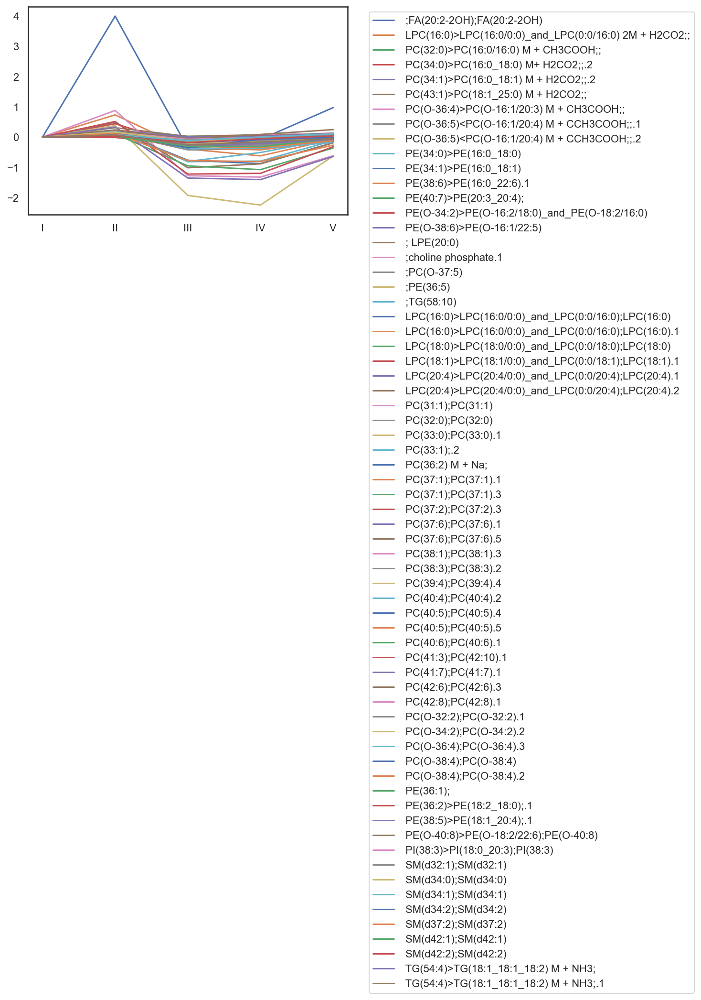

In [52]:
# generate dataframe that contains log2 fold change of metabolites
fc_upload = timepoint_fold_change(features, stages, 'normalize to timepoint1')

# plot dendogram
metabolic_clusters_DKO = print_clusters(fc_upload, 10, plot=True)

### Zoom in on Clusters

In [53]:
# generate dataframe that contains log2 fold change of metabolites
# already run above
# fc_upload = timepoint_fold_change(features, stages, 'normalize to timepoint1')

# plot dendogram
metabolic_clusters_DKO = print_clusters(fc_upload, 10, plot=False)

In [54]:
# Select the cluster to be investigated: 
metabolic_clusters_DKO_select = metabolic_clusters_DKO[1]

In [55]:
# get the first value in cluster, this is the cluster ID. 
clus = metabolic_clusters_DKO_select['cluster'][1]

# plot the graph and use cluster number as title. 
metabolic_clusters_DKO_select.drop(['cluster'], axis=1).hvplot.line(legend = 'right', 
                                                         width=1000, height=400,
                                                         fontsize = '7pt', 
                                                         title = 'cluster %d' % clus)

:NdOverlay   [features]
   :Curve   [index]   (value)

### Clusters Heatmap

In [56]:
metabolic_clusters_DKO_select.drop(['cluster'], axis=1).T.hvplot.heatmap(
    width=700, 
    height=500,
    colorbar='Log2',
    title = 'Longitudinal metabolite changes of cluster x',
    cmap=["#75968f", "#a5bab7", "#c9d9d3", "#e2e2e2", "#dfccce", "#ddb7b1", "#cc7878", "#933b41", "#550b1d"])

:HeatMap   [columns,index]   (value)

In [57]:
metabolic_clusters_DKO_select.columns

Index([' ;;FA(11:3)', ' ;;FA(17:2-OH).1', ' ;11-deoxycortisol;deoxycortisol',
       ' ;FA(16:3);FA(16:3).1', ' ;FA(18:4);FA(18:4).1',
       ' ;FA(20:2-OH);FA(20:2-OH)', ' ;FA(22:5);FA(22:5)',
       ' ;PE(16:1);PE(16:1)', ' ;progesterone;progesterone',
       ' ;retinoate;retinoate', ' ;testosterone;testosterone.1',
       ' 14(S)-HDHA;;', ' CP 47,497-C8-Homolog C-8-hydroxy metabolite;;',
       ' FA(20:3-OH);FA(20:3-OH)', ' FA(20:4-OH);FA(20:4-OH)',
       ' FA(20:5);FA(20:5(5Z,8Z,11Z,14Z,17Z)));.1', ' FA(20:5-OH).1',
       ' FA(22:6);FA(22:6);', ' HexCer(d36:0) M + CH3COOH;;',
       ' HexCer(d36:0) M + CH3COOH;;.2', ' LPC(16:0) M + CH3COOH;;',
       ';FA(17:3-OH)', ' PC(34:1)>PC(16:0_18:1)_M+CH3COOH;;',
       ' PC(38:3)>PC(18:0_20:3) M + CH3COOH;;',
       ' PC(38:5)>PC(18:1_20:4)_and_PC(38:5)>PC(16:0_22:5) M + CH3COOH;;',
       ' PC(38:5)>PC(18:1_20:4)_and_PC(38:5)>PC(16:0_22:5) M + CH3COOH;;.1',
       ' PC(38:5)>PC(18:1_20:4)_and_PC(38:5)>PC(16:0_22:5) M + CH3COOH;;.2',
   

**Reduce this set of metabolites.**

In [58]:
select = [' ;progesterone;progesterone', ' ;testosterone;testosterone.1',
         ' ;FA(18:4);FA(18:4).1', ' ;FA(22:5);FA(22:5)',
         ' FA(20:3-OH);FA(20:3-OH)', ' FA(20:4-OH);FA(20:4-OH)',
         ' FA(20:5);FA(20:5(5Z,8Z,11Z,14Z,17Z)));.1', ' PI(38:4);PI(38:4);']

In [59]:
metabolic_clusters_DKO_select[select].T.hvplot.heatmap(
    width=500, 
    height=400,
    colorbar='Log2',
    title = 'Longitudinal metabolite changes of cluster x',
    cmap=["#75968f", "#a5bab7", "#c9d9d3", "#e2e2e2", "#dfccce", "#ddb7b1", "#cc7878", "#933b41", "#550b1d"])

:HeatMap   [columns,index]   (value)

### Network Graphs

In [60]:
# -1 was used to remove 'cluster' a non-relevant string label
metabolic_clusters_DKO_select.columns[:-1] ;

In [61]:
networkGraph(df[metabolic_clusters_DKO_select.columns[:-1]], 0.5, 'Viridis')

### [Go to Table of Contents](#0) <br>

## 6. Some Code References
<a id='6'></a>

 - [Matplotlib specifying colors](https://matplotlib.org/stable/tutorials/colors/colors.html)
 - [hvplot user guide](https://hvplot.holoviz.org/user_guide/index.html)
 - [A video tutorial on hvplot](https://www.youtube.com/watch?v=am0iMNa9-1M)<br>
 - [hvplot implementation computational essay](https://coderzcolumn.com/tutorials/data-science/how-to-convert-static-pandas-plot-matplotlib-to-interactive-hvplot)
 -[PCA visualization via plotly](https://plotly.com/python/pca-visualization/)
 - [UMAP and tSNE via plotly](https://plotly.com/python/t-sne-and-umap-projections/) 
 - [Plotly clustered heatmap (with dendrogram)/Python]( https://stackoverflow.com/questions/66547583/plotly-clustered-heatmap-with-dendrogram-python)
 - [Clustering model comparison with plotly](https://www.kaggle.com/agustinpugliese/clustering-model-comparison-with-plotly)
 - [Extract Clusters from Python Dendrogram](https://nbviewer.org/gist/vals/150ec97a5b7db9c82ee9#Extract-Clusters-from-Python-Dendrogram)
 - [Hierarchical Clustering: Extract observations from large heatmap](https://datascience.stackexchange.com/questions/61417/hierarchical-clustering-extract-observations-from-large-heatmap)